In [1]:
import music21

In [2]:
import librosa

In [3]:
songpath = "C:/Users/admin_local/Dropbox/music/test.m4a"

In [4]:
y_orig, sr_orig = librosa.load(songpath, sr=None)

In [5]:
sr = 22050

y = librosa.resample(y_orig, sr_orig, sr)

In [6]:
D = librosa.stft(y)

In [7]:
import numpy as np
S, phase = librosa.magphase(D)
print(S.dtype, phase.dtype, np.allclose(D, S * phase))

(dtype('float32'), dtype('complex64'), True)


In [8]:
C = librosa.cqt(y, sr=sr)
print(C.dtype)

complex128


In [9]:
melspec = librosa.feature.melspectrogram(y=y, sr=sr)

# Melspec assumes power, not energy as input
melspec_stft = librosa.feature.melspectrogram(S=S**2, sr=sr)
mfcc = librosa.feature.mfcc(y=y, sr=sr)
chroma = librosa.feature.chroma_cqt(y=y, sr=sr)


In [10]:
print(melspec.size)
print(mfcc.size)
print(chroma.size)

2104576
328840
197304


In [34]:
# Displays are built with matplotlib 
import matplotlib.pyplot as plt

# Let's make plots pretty
import matplotlib.style as ms
ms.use('seaborn-muted')

# Render figures interactively in the notebook
# %matplotlib nbagg

# IPython gives us an audio widget for playback
from IPython.display import Audio
print(librosa.__version__)

0.5.1


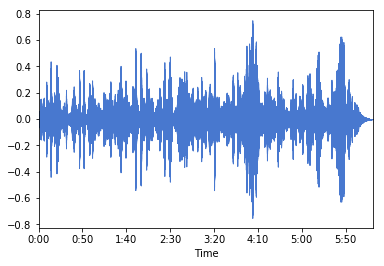

In [16]:
import librosa.display
plt.figure()
librosa.display.waveplot(y=y, sr=sr)

<IPython.core.display.Javascript object>


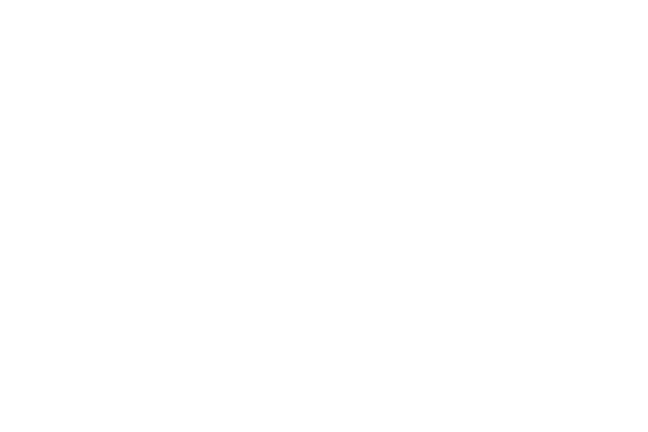

<IPython.core.display.Javascript object>


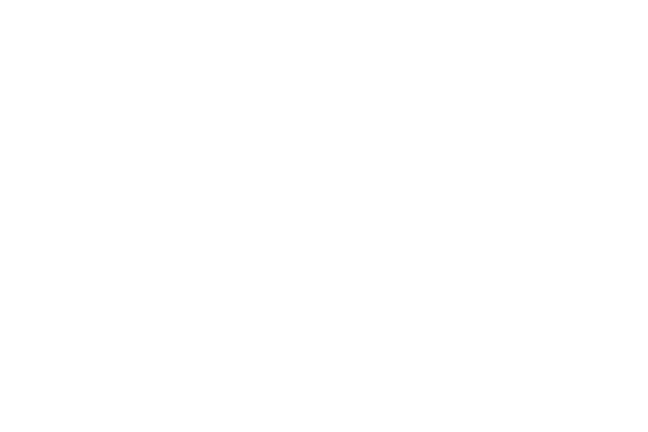

In [35]:
plt.figure()
librosa.display.specshow(melspec, y_axis='mel', x_axis='time')
plt.colorbar()
plt.savefig("mel.png")

<IPython.core.display.Javascript object>


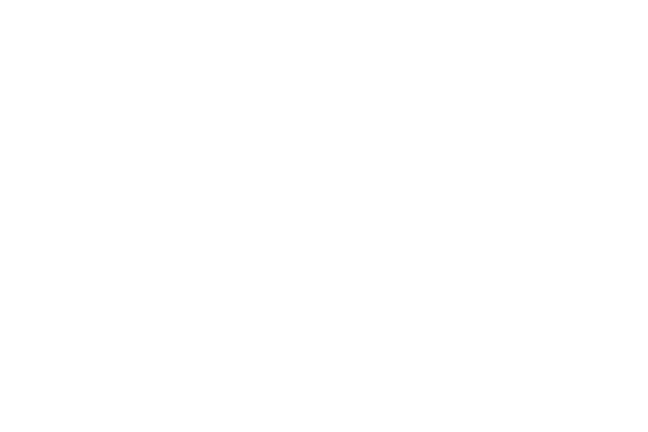

<IPython.core.display.Javascript object>


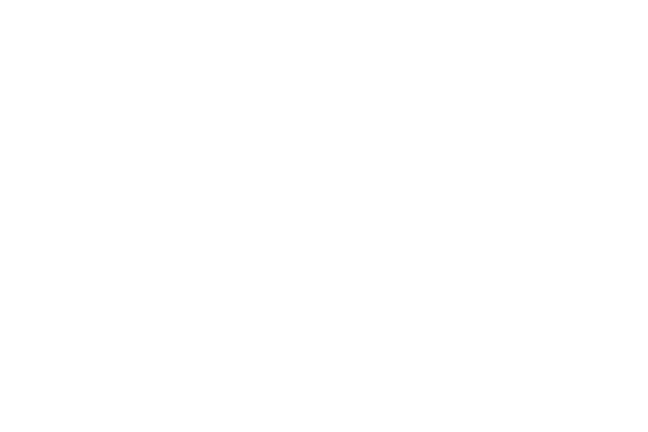

In [36]:
plt.figure()
librosa.display.specshow(chroma, y_axis='mel', x_axis='time')
plt.savefig('chroma.png')

In [22]:
tempo, beats = librosa.beat.beat_track(y=y, sr=sr)
print(tempo)
print(beats)

161.499023438
[   91   107   123   139   155   171   187   203   219   236   253   270
   287   304   321   338   355   372   388   405   421   437   453   469
   485   501   517   533   549   565   581   597   613   629   645   661
   678   695   712   728   743   759   775   791   808   825   842   858
   879   895   912   929   947   964   982  1000  1018  1034  1050  1066
  1082  1098  1114  1130  1146  1162  1178  1194  1210  1226  1243  1260
  1277  1294  1311  1328  1345  1361  1377  1393  1409  1425  1441  1457
  1473  1489  1505  1521  1537  1554  1571  1588  1605  1622  1639  1656
  1673  1690  1708  1726  1742  1758  1774  1790  1806  1822  1838  1854
  1870  1886  1902  1918  1935  1952  1969  1986  2001  2016  2031  2046
  2062  2078  2094  2110  2126  2142  2158  2174  2190  2206  2222  2238
  2254  2270  2286  2302  2318  2334  2351  2368  2385  2402  2419  2436
  2453  2470  2484  2499  2515  2531  2546  2562  2578  2594  2610  2627
  2643  2659  2675  2691  2707  2723 

<IPython.core.display.Javascript object>


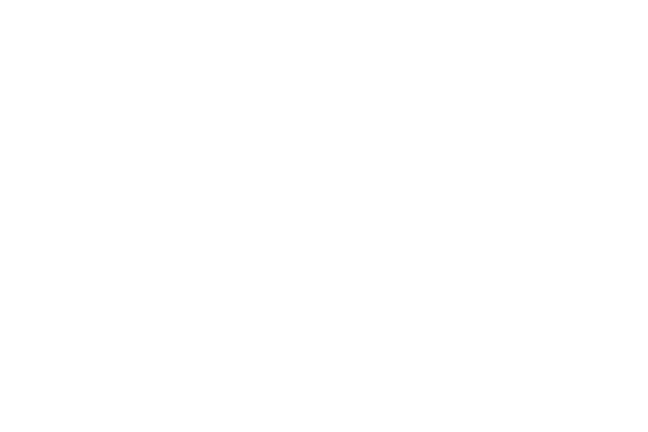

<IPython.core.display.Javascript object>


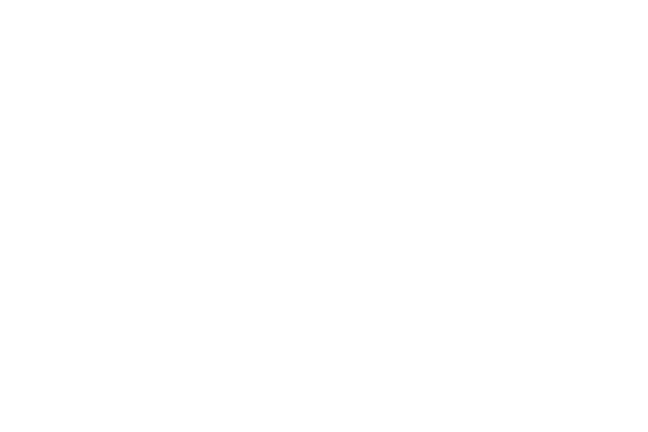

In [47]:
clicks = librosa.clicks(frames=beats, sr=sr, length=len(y))
import pickle
plt.figure()
plt.plot(clicks[0:100000])
plt.show()
Audio(data=y + clicks, rate=sr)


In [42]:

pickle.dump(y + clicks, open( "clicks.p", "wb" ) )
pickle.dump(clicks, open( "clicksonly.p", "wb" ))
pickle.dump(melspec, open("mel.p", "wb"))
pickle.dump(mfcc, open( "mfcc.p", "wb" ) )
pickle.dump(chroma, open("chroma.p", "wb"))


In [48]:
pickle.dump(beats, open("beats.p", "wb"))

In [23]:

chroma_sync = librosa.util.sync(chroma, beats)

In [24]:
R = librosa.segment.recurrence_matrix(chroma_sync)


In [26]:
print(R)

[[False  True False ..., False False False]
 [False False False ..., False False False]
 [False False False ..., False False False]
 ..., 
 [False False False ..., False False False]
 [False False False ..., False False False]
 [ True  True False ..., False False False]]


<IPython.core.display.Javascript object>


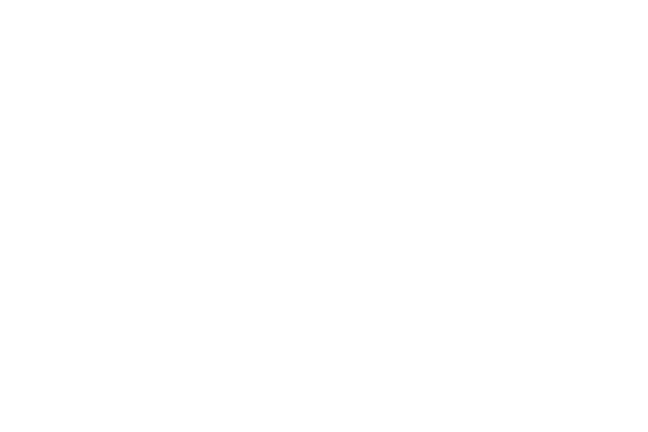

<IPython.core.display.Javascript object>


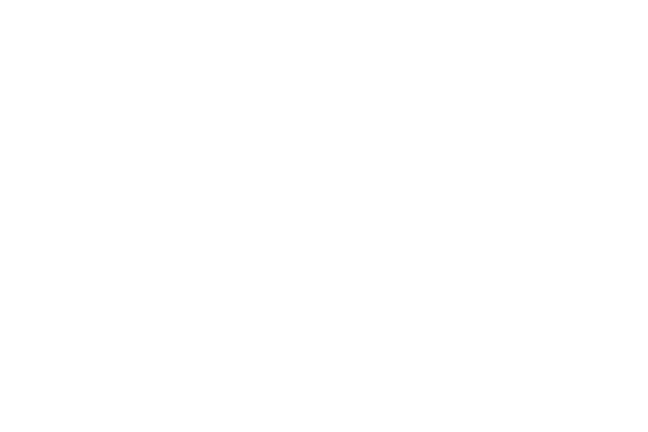

In [27]:
plt.figure()
plt.imshow(R)
plt.show()

<IPython.core.display.Javascript object>


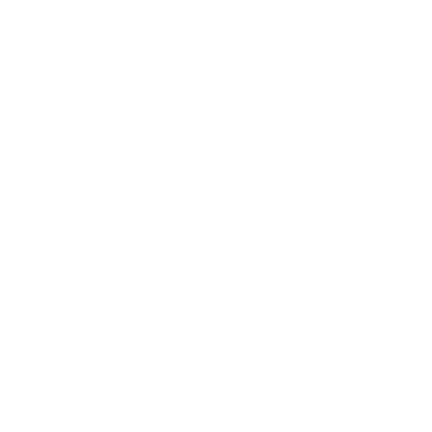

<IPython.core.display.Javascript object>


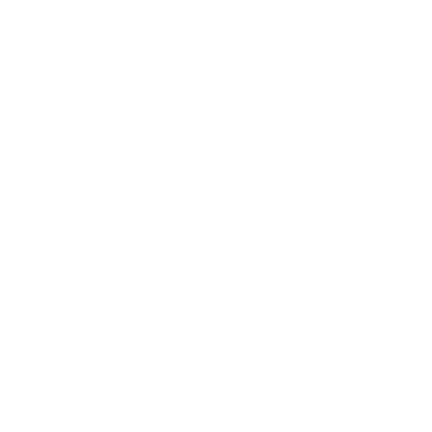

In [33]:
plt.figure(figsize=(4, 4))
librosa.display.specshow(R)
plt.savefig('R.png')

In [29]:
R2 = librosa.segment.recurrence_matrix(chroma_sync,
                                       mode='affinity',
                                       sym=True)

<IPython.core.display.Javascript object>


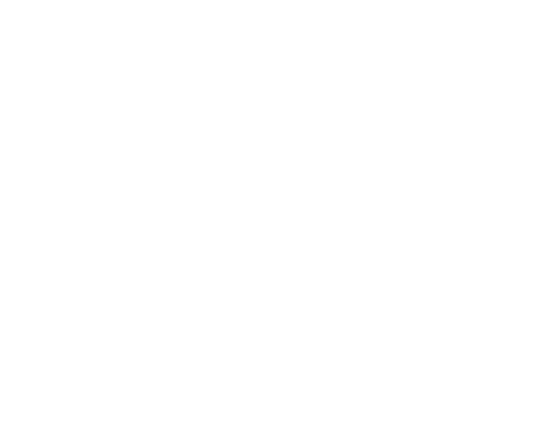

<IPython.core.display.Javascript object>


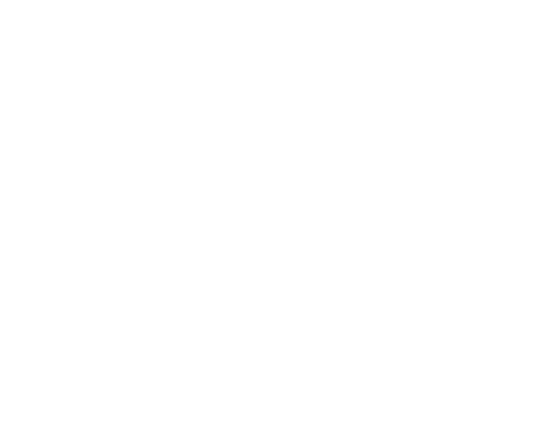

In [37]:
plt.figure(figsize=(5, 4))
librosa.display.specshow(R2)
plt.colorbar()
plt.savefig('R2.png')

<IPython.core.display.Javascript object>


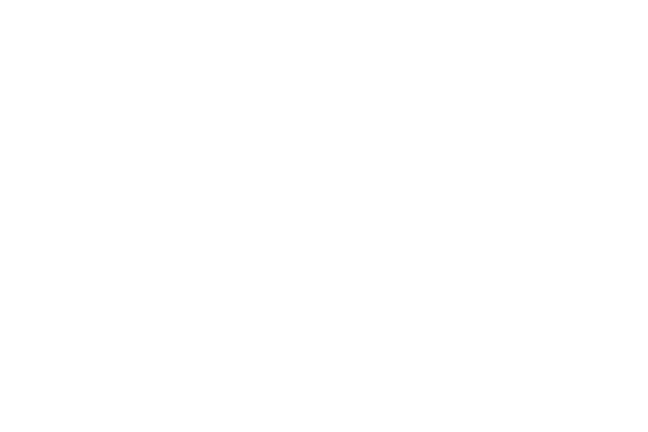

<IPython.core.display.Javascript object>


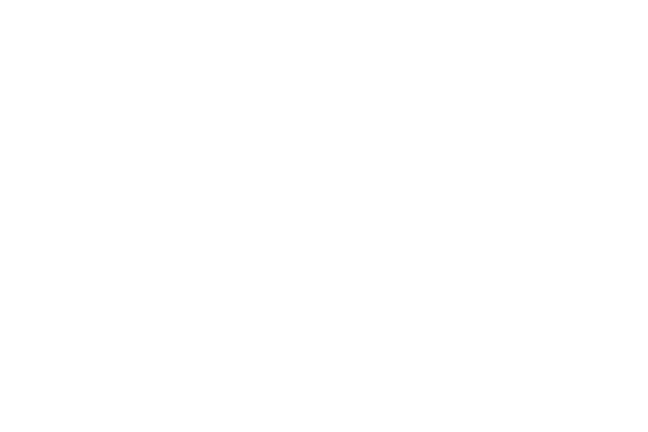

In [38]:
plt.figure()
librosa.display.specshow(mfcc, y_axis='mel', x_axis='time')
plt.colorbar()
plt.savefig("mfcc.png")